In [1]:
!curl -L "https://universe.roboflow.com/ds/glquRaJDf9?key=1kWinBXVTQ" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip

Streaming output truncated to the last 5000 lines.
  inflating: train/labels/001677_JPG_jpg.rf.414e120831f7e7f30447cb3cb26bdc83.txt  
 extracting: train/labels/001677_JPG_jpg.rf.d0e22a225cbb317066ae2e6efd3dbcc2.txt  
  inflating: train/labels/001678_JPG_jpg.rf.21782caf845bde6574cb51b3f5c74490.txt  
  inflating: train/labels/001678_JPG_jpg.rf.4de99d4836e879bc0a6b13d15eefe346.txt  
  inflating: train/labels/001678_JPG_jpg.rf.d9b987c7dd66459a58b74d90a6970de7.txt  
  inflating: train/labels/001679_JPG_jpg.rf.7f8083798d74d6e40543f776ec116c6a.txt  
  inflating: train/labels/001679_JPG_jpg.rf.c11f3850b8f5630a0b21810e0a256c90.txt  
  inflating: train/labels/001679_JPG_jpg.rf.f0cdb80eb57c2cf67c5306cbf7c19aac.txt  
  inflating: train/labels/001680_JPG_jpg.rf.05690ffb9e45dcb471a95f0b96806331.txt  
  inflating: train/labels/001680_JPG_jpg.rf.8472e670be11dc0438f4a3e001e124bb.txt  
  inflating: train/labels/001680_JPG_jpg.rf.fc6132ab57b715e2192ea08bbc90067d.txt  
  inflating: train/labels/001681_JPG

In [2]:
!pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 949.8/949.8 kB 30.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 2.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 78.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 61.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 47.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 6.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 13.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 93.6 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstall

In [ ]:
import torch
from ultralytics import YOLO
import torch.nn.functional as F
from util import compare_original_and_adversarial,preprocess_image, compare_original_and_adversarial_png,sample_images_by_class
from attacks import train_universal_attack

In [4]:
model = YOLO("yolov8n_TrafficSigns.pt")

In [6]:
images_dir = "/content/train/images"
labels_dir = "/content/train/labels"
num_per_class = 100

final_image_paths, dist = sample_images_by_class(images_dir, labels_dir, num_per_class)
print(f"Collected {len(final_image_paths)} total images after balancing.")
print("Some sample images:", final_image_paths[:5])
for c, cnt in dist.items():
  print(f"Class {c}: {cnt}")

Collected 1424 total images after balancing.
Some sample images: ['/content/train/images/000034_jpg.rf.7604feb74ad954b2b2b117884c800375.jpg', '/content/train/images/001072_jpg.rf.5f23c6bebea12c9ef3d20abe2710ead5.jpg', '/content/train/images/road544_png.rf.366cf0608c40ded32332bf885c899f8a.jpg', '/content/train/images/00002_00016_00016_png.rf.37c1f9a0883f22bc0a6513ebd8a1a90e.jpg', '/content/train/images/00008_00038_00019_png.rf.5cba31e6a27adfb204d8c0d6853ac43e.jpg']
Class 4: 106
Class 13: 122
Class 7: 114
Class 14: 105
Class 3: 120
Class 0: 153
Class 9: 107
Class 5: 120
Class 11: 117
Class 12: 124
Class 1: 201
Class 8: 104
Class 10: 117
Class 6: 119
Class 2: 42


In [10]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

delta, losses = train_universal_attack(
    model,
    final_image_paths,
    preprocess_image,
    device=device,
    num_epochs_uap=10,
    lambda_reg=0.01,
    epsilon=0.1,
    conf_threshold=0.2,
    lr=0.1,
    momentum=0.9
)

UAP Epoch [1/10] Loss: 0.9451
UAP Epoch [2/10] Loss: 0.9405
UAP Epoch [3/10] Loss: 0.9421
UAP Epoch [4/10] Loss: 0.9361
UAP Epoch [5/10] Loss: 0.9485
UAP Epoch [6/10] Loss: 0.9701
UAP Epoch [7/10] Loss: 0.9569
UAP Epoch [8/10] Loss: 0.9475
UAP Epoch [9/10] Loss: 0.9500
UAP Epoch [10/10] Loss: 0.9419
Training complete.


In [12]:
# Save the learned universal perturbation
torch.save(delta, "universal_delta_1_epsilon.pth")

# Later, load it with:
#   delta_loaded = torch.load("universal_delta.pth")

In [15]:
test_images_dir = "/content/test/images"
test_labels_dir = "/content/test/labels"
num_per_class = 2

test_images_paths, dist = sample_images_by_class(images_dir, labels_dir, num_per_class)
print(f"Collected {len(test_images_paths)} total images after balancing.")
print("Some sample images:", test_images_paths[:5])
for c, cnt in dist.items():
  print(f"Class {c}: {cnt}")

Collected 30 total images after balancing.
Some sample images: ['/content/train/images/000820_jpg.rf.b2de65d98efd00a10a93c4f7b529774c.jpg', '/content/train/images/FisheyeCamera_1_00274_png.rf.25f6fc164c5b0e6dc20c5cb8a7a87b1e.jpg', '/content/train/images/001440_jpg.rf.38a6b988249db8e3b5011baba6715709.jpg', '/content/train/images/000884_JPG_jpg.rf.fa613a2f973be2821061fcc26457e166.jpg', '/content/train/images/00005_00013_00020_png.rf.8003993f2ee1e2d5fcc8bd27b2af8852.jpg']
Class 4: 3
Class 13: 2
Class 7: 2
Class 14: 2
Class 3: 2
Class 0: 3
Class 9: 2
Class 5: 2
Class 11: 2
Class 12: 2
Class 1: 3
Class 8: 2
Class 10: 2
Class 6: 2
Class 2: 2


Running prediction on original tensor...

0: 640x640 1 Speed Limit 90, 8.4ms
Speed: 2.6ms preprocess, 8.4ms inference, 87.9ms postprocess per image at shape (1, 3, 640, 640)
Running prediction on loaded adversarial tensor...

0: 640x640 (no detections), 7.4ms
Speed: 2.0ms preprocess, 7.4ms inference, 13.4ms postprocess per image at shape (1, 3, 640, 640)


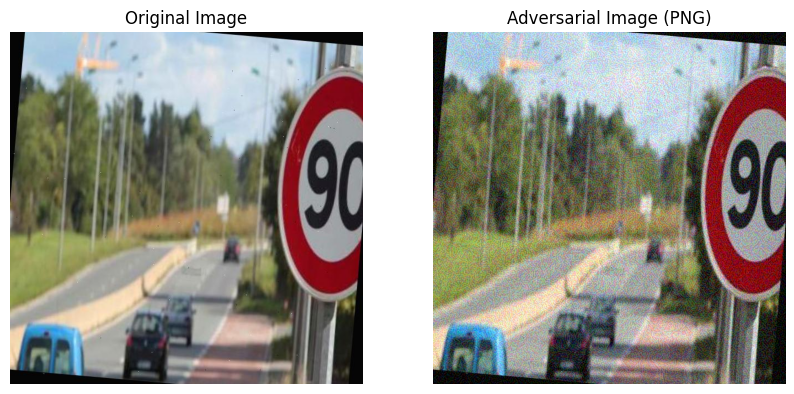

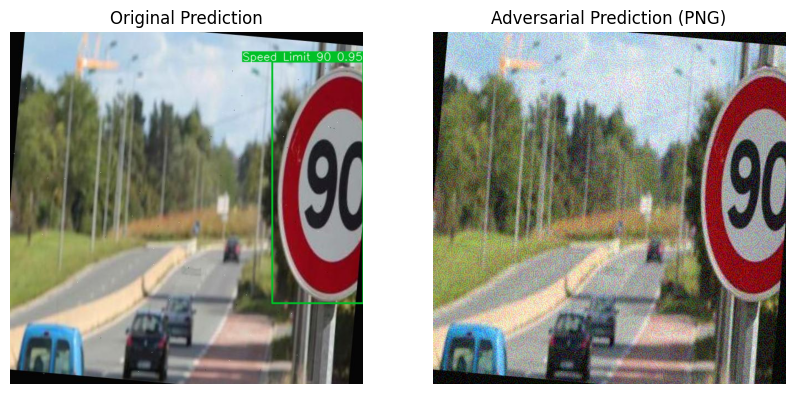

Running prediction on original tensor...

0: 640x640 1 Green Light, 9.5ms
Speed: 3.8ms preprocess, 9.5ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)
Running prediction on loaded adversarial tensor...

0: 640x640 (no detections), 9.5ms
Speed: 1.2ms preprocess, 9.5ms inference, 12.6ms postprocess per image at shape (1, 3, 640, 640)


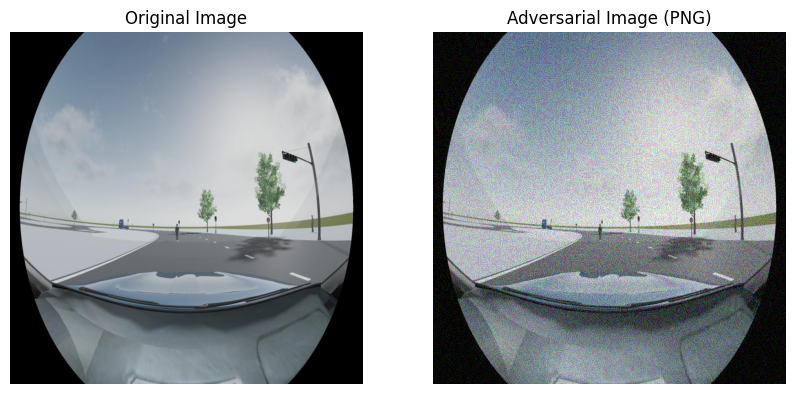

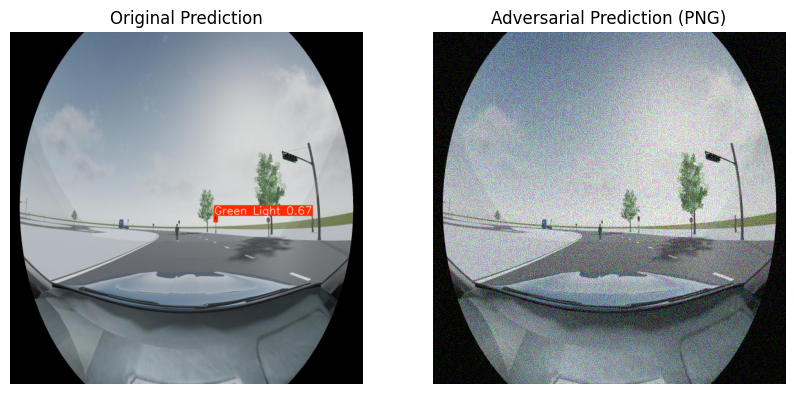

Running prediction on original tensor...

0: 640x640 1 Speed Limit 120, 10.1ms
Speed: 1.4ms preprocess, 10.1ms inference, 4.6ms postprocess per image at shape (1, 3, 640, 640)
Running prediction on loaded adversarial tensor...

0: 640x640 (no detections), 9.9ms
Speed: 1.3ms preprocess, 9.9ms inference, 12.0ms postprocess per image at shape (1, 3, 640, 640)


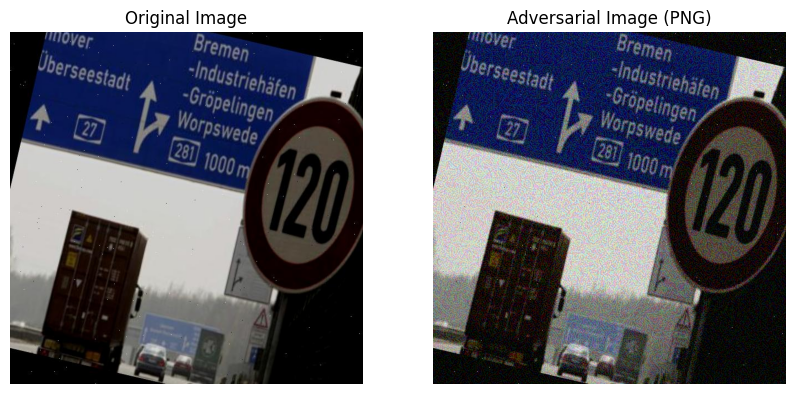

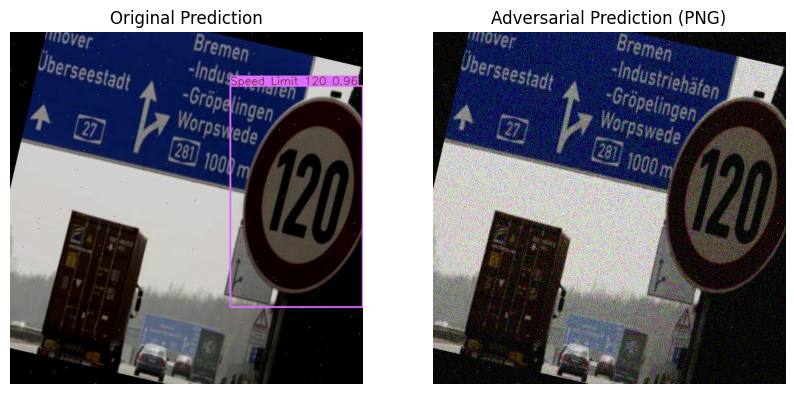

Running prediction on original tensor...

0: 640x640 1 Green Light, 8.8ms
Speed: 1.2ms preprocess, 8.8ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)
Running prediction on loaded adversarial tensor...

0: 640x640 (no detections), 8.6ms
Speed: 1.5ms preprocess, 8.6ms inference, 8.4ms postprocess per image at shape (1, 3, 640, 640)


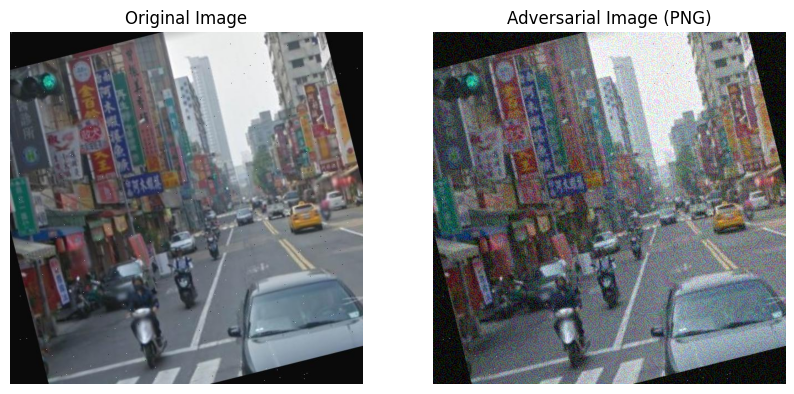

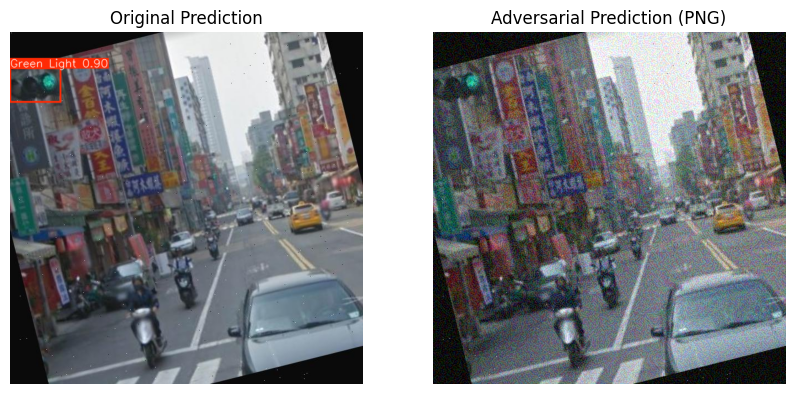

Running prediction on original tensor...

0: 640x640 1 Speed Limit 80, 12.1ms
Speed: 1.4ms preprocess, 12.1ms inference, 4.5ms postprocess per image at shape (1, 3, 640, 640)
Running prediction on loaded adversarial tensor...

0: 640x640 (no detections), 9.6ms
Speed: 1.2ms preprocess, 9.6ms inference, 9.0ms postprocess per image at shape (1, 3, 640, 640)


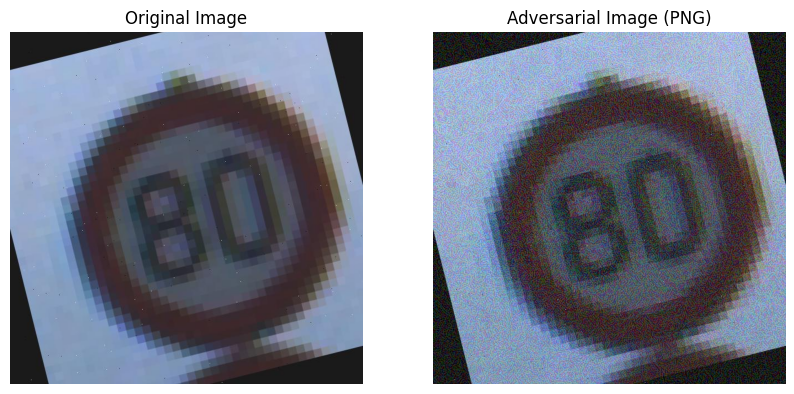

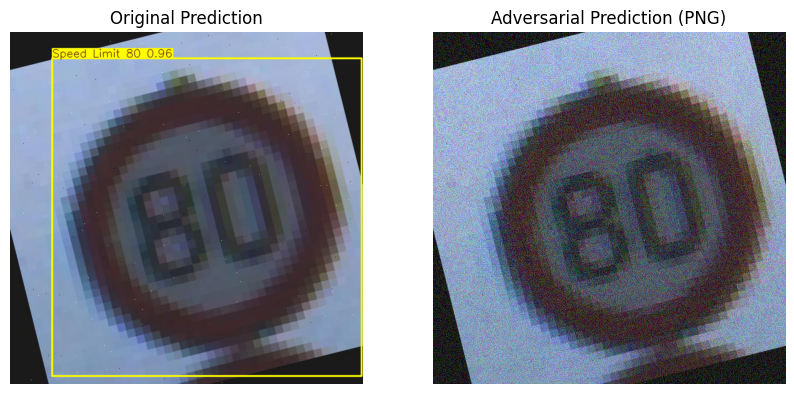

Running prediction on original tensor...

0: 640x640 1 Speed Limit 60, 11.1ms
Speed: 1.4ms preprocess, 11.1ms inference, 4.7ms postprocess per image at shape (1, 3, 640, 640)
Running prediction on loaded adversarial tensor...

0: 640x640 (no detections), 9.1ms
Speed: 1.4ms preprocess, 9.1ms inference, 16.9ms postprocess per image at shape (1, 3, 640, 640)


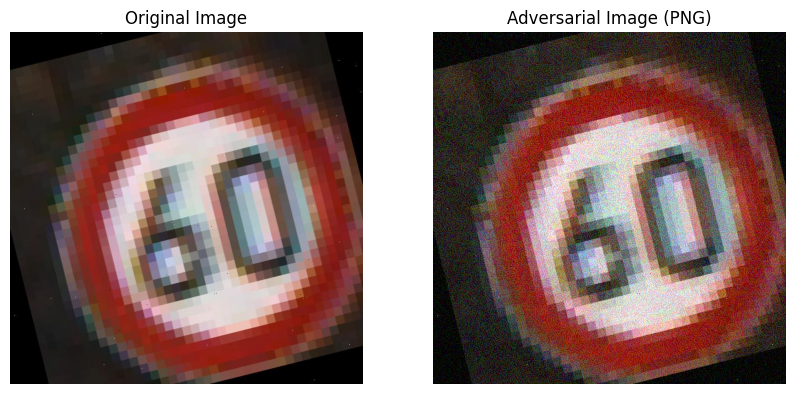

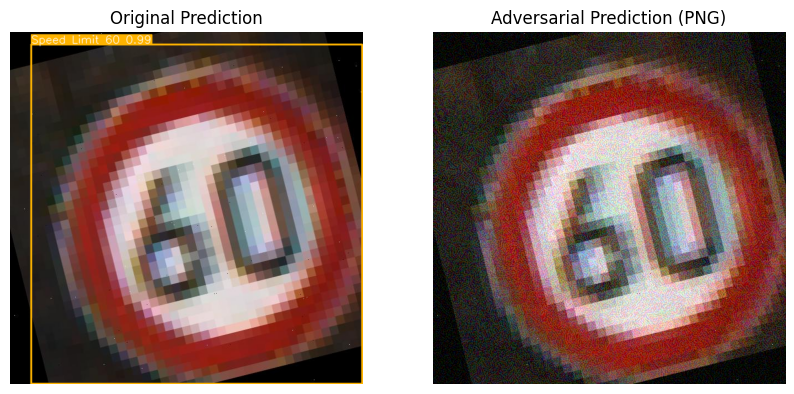

Running prediction on original tensor...

0: 640x640 1 Red Light, 9.6ms
Speed: 1.4ms preprocess, 9.6ms inference, 4.4ms postprocess per image at shape (1, 3, 640, 640)
Running prediction on loaded adversarial tensor...

0: 640x640 (no detections), 9.4ms
Speed: 1.3ms preprocess, 9.4ms inference, 9.1ms postprocess per image at shape (1, 3, 640, 640)


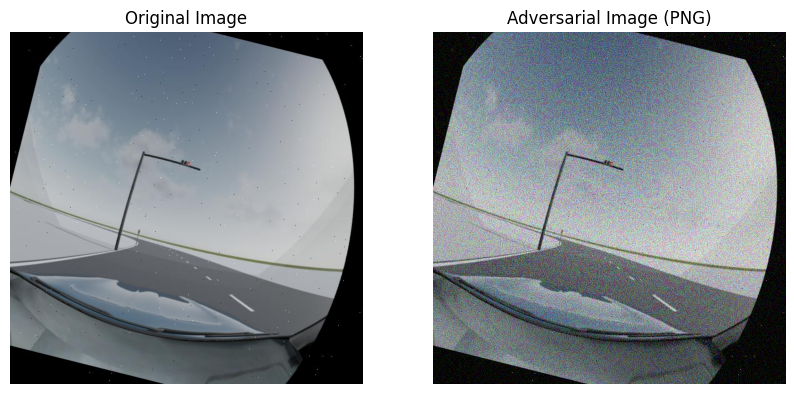

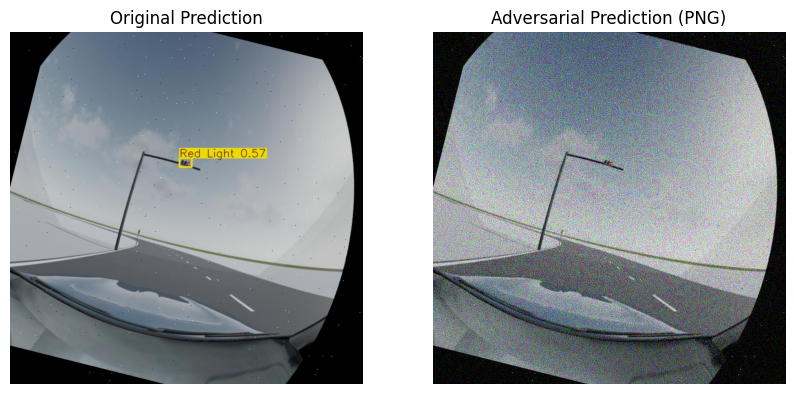

Running prediction on original tensor...

0: 640x640 (no detections), 9.5ms
Speed: 1.2ms preprocess, 9.5ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)
Running prediction on loaded adversarial tensor...

0: 640x640 (no detections), 8.7ms
Speed: 1.3ms preprocess, 8.7ms inference, 8.7ms postprocess per image at shape (1, 3, 640, 640)


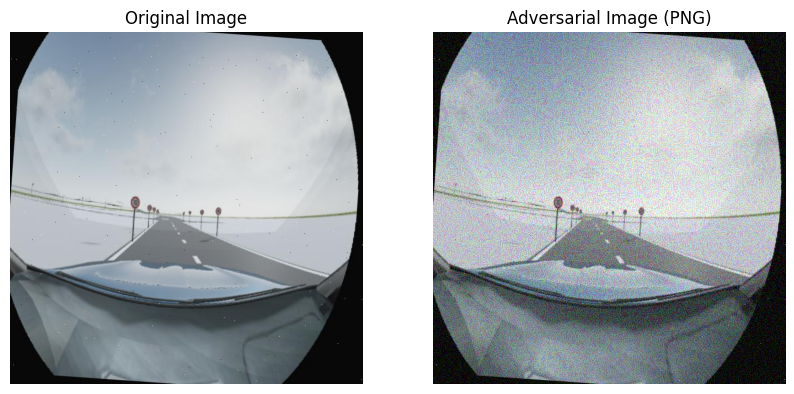

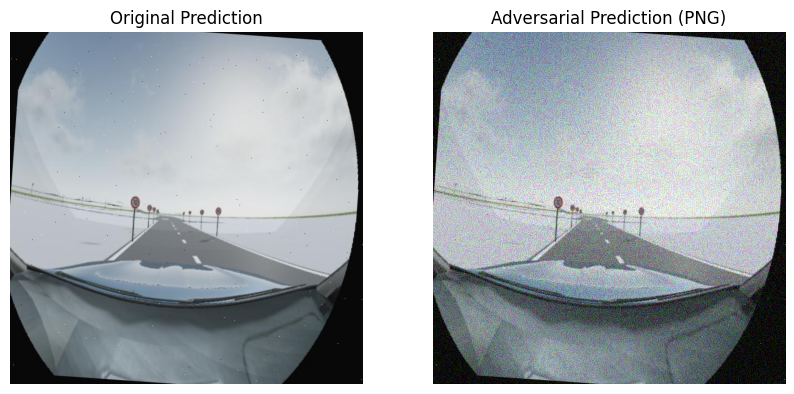

Running prediction on original tensor...

0: 640x640 1 Speed Limit 100, 12.2ms
Speed: 1.2ms preprocess, 12.2ms inference, 4.6ms postprocess per image at shape (1, 3, 640, 640)
Running prediction on loaded adversarial tensor...

0: 640x640 (no detections), 14.2ms
Speed: 1.3ms preprocess, 14.2ms inference, 8.7ms postprocess per image at shape (1, 3, 640, 640)


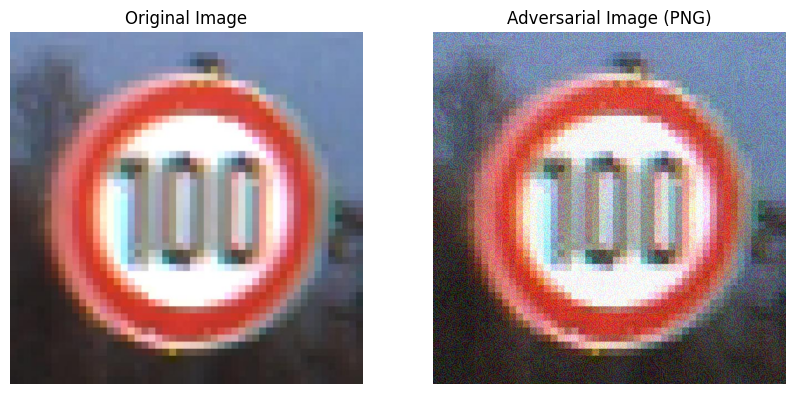

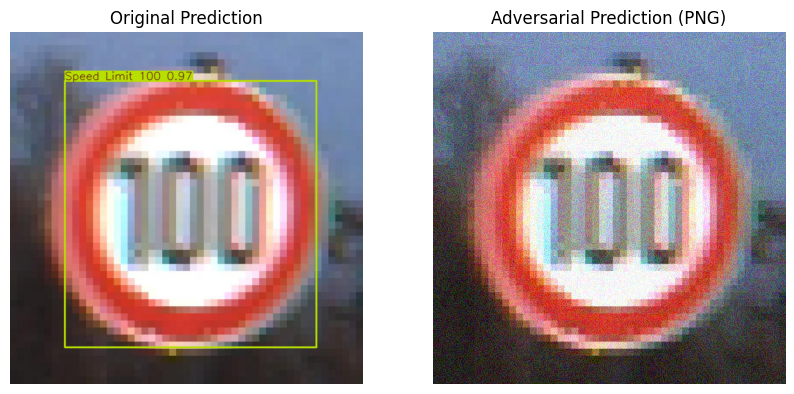

Running prediction on original tensor...

0: 640x640 1 Speed Limit 110, 12.9ms
Speed: 1.2ms preprocess, 12.9ms inference, 11.0ms postprocess per image at shape (1, 3, 640, 640)
Running prediction on loaded adversarial tensor...

0: 640x640 1 Stop, 13.3ms
Speed: 1.3ms preprocess, 13.3ms inference, 18.1ms postprocess per image at shape (1, 3, 640, 640)


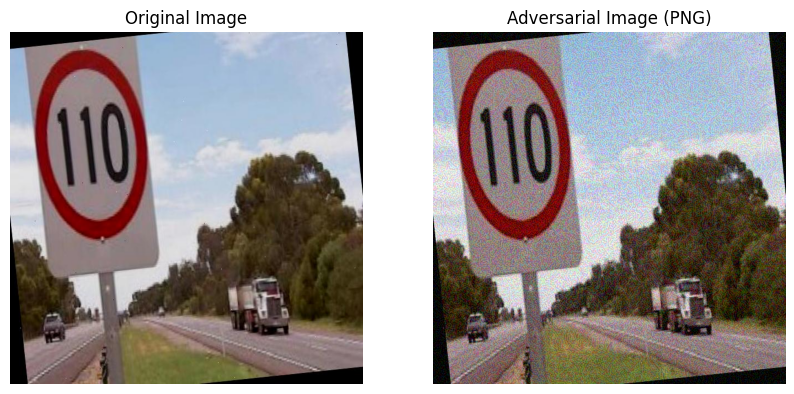

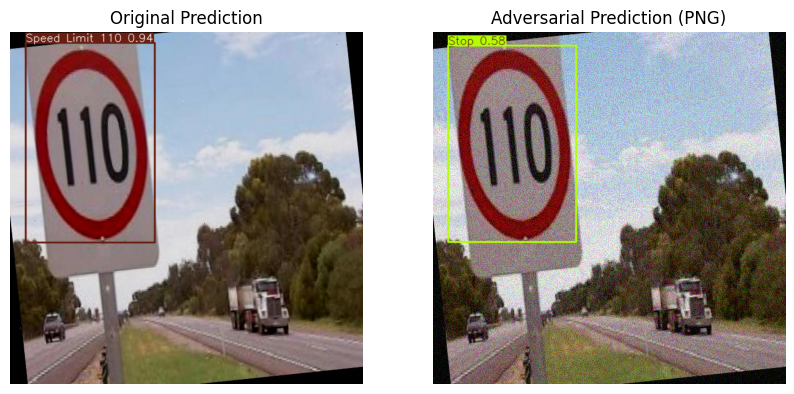

Running prediction on original tensor...

0: 640x640 1 Speed Limit 110, 13.1ms
Speed: 1.1ms preprocess, 13.1ms inference, 8.4ms postprocess per image at shape (1, 3, 640, 640)
Running prediction on loaded adversarial tensor...

0: 640x640 1 Speed Limit 100, 9.6ms
Speed: 1.2ms preprocess, 9.6ms inference, 6.5ms postprocess per image at shape (1, 3, 640, 640)


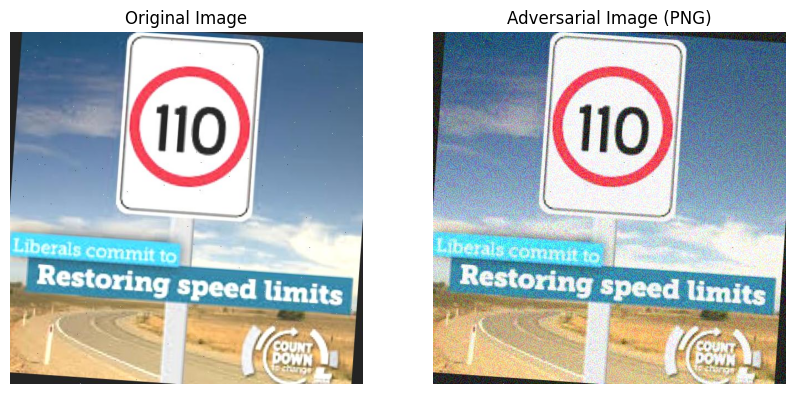

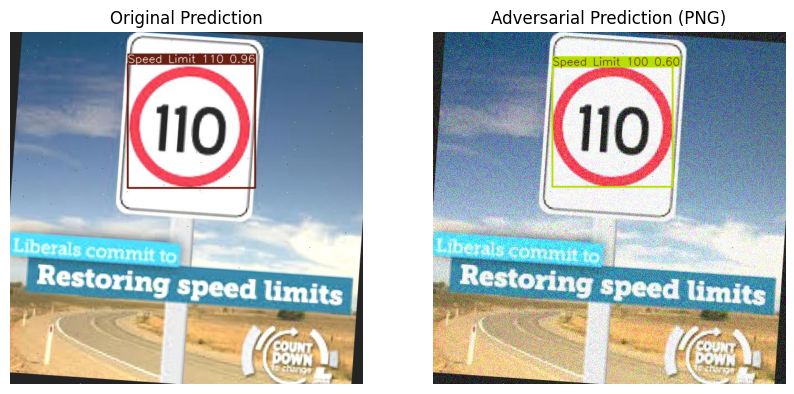

Running prediction on original tensor...

0: 640x640 1 Speed Limit 50, 9.1ms
Speed: 1.1ms preprocess, 9.1ms inference, 4.6ms postprocess per image at shape (1, 3, 640, 640)
Running prediction on loaded adversarial tensor...

0: 640x640 1 Speed Limit 50, 8.2ms
Speed: 1.2ms preprocess, 8.2ms inference, 7.1ms postprocess per image at shape (1, 3, 640, 640)


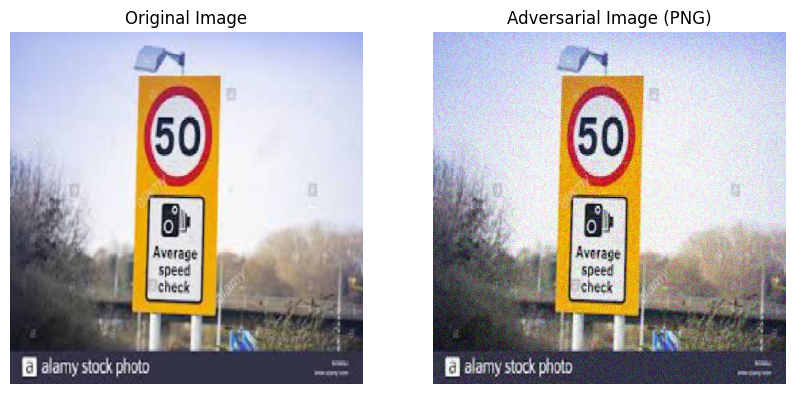

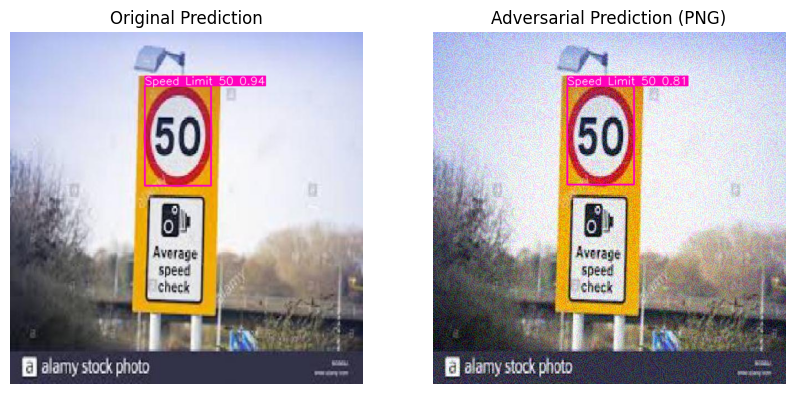

Running prediction on original tensor...

0: 640x640 1 Speed Limit 80, 8.7ms
Speed: 1.2ms preprocess, 8.7ms inference, 4.6ms postprocess per image at shape (1, 3, 640, 640)
Running prediction on loaded adversarial tensor...

0: 640x640 1 Speed Limit 80, 11.6ms
Speed: 1.3ms preprocess, 11.6ms inference, 11.7ms postprocess per image at shape (1, 3, 640, 640)


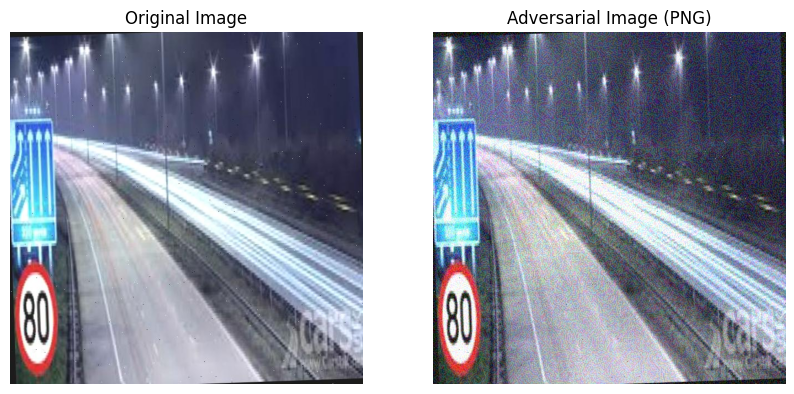

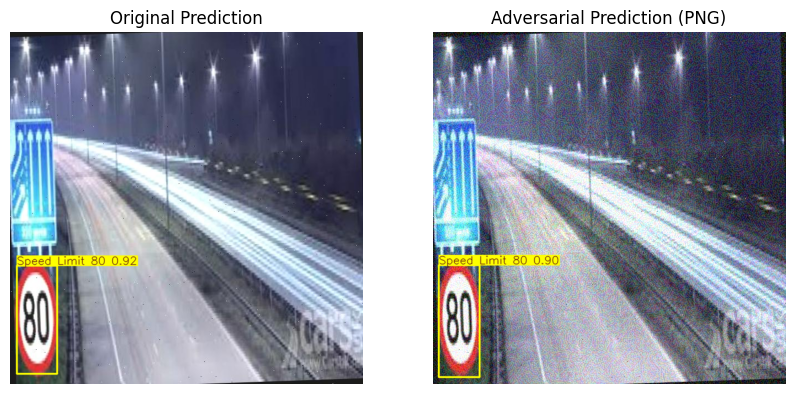

Running prediction on original tensor...

0: 640x640 1 Stop, 8.7ms
Speed: 1.2ms preprocess, 8.7ms inference, 4.5ms postprocess per image at shape (1, 3, 640, 640)
Running prediction on loaded adversarial tensor...

0: 640x640 (no detections), 9.6ms
Speed: 1.2ms preprocess, 9.6ms inference, 9.0ms postprocess per image at shape (1, 3, 640, 640)


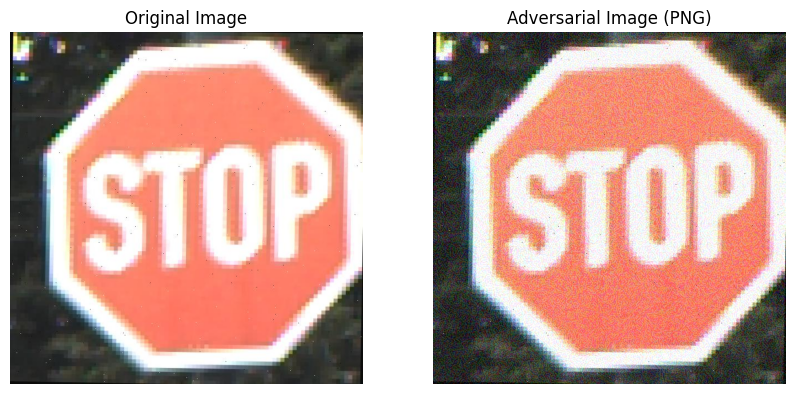

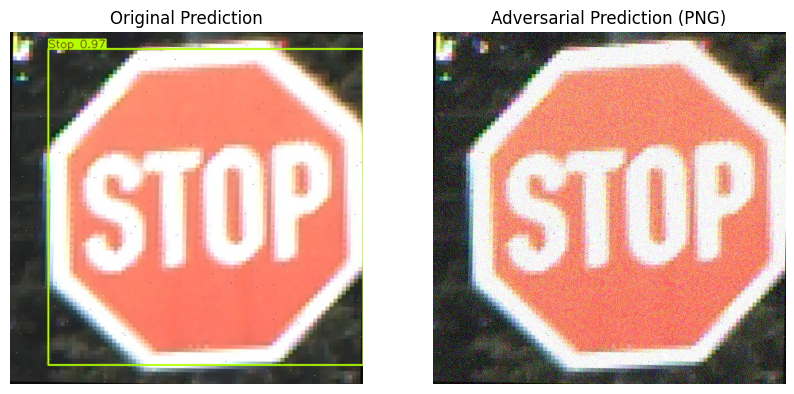

Running prediction on original tensor...

0: 640x640 1 Speed Limit 20, 11.1ms
Speed: 1.2ms preprocess, 11.1ms inference, 4.4ms postprocess per image at shape (1, 3, 640, 640)
Running prediction on loaded adversarial tensor...

0: 640x640 (no detections), 8.8ms
Speed: 1.2ms preprocess, 8.8ms inference, 8.9ms postprocess per image at shape (1, 3, 640, 640)


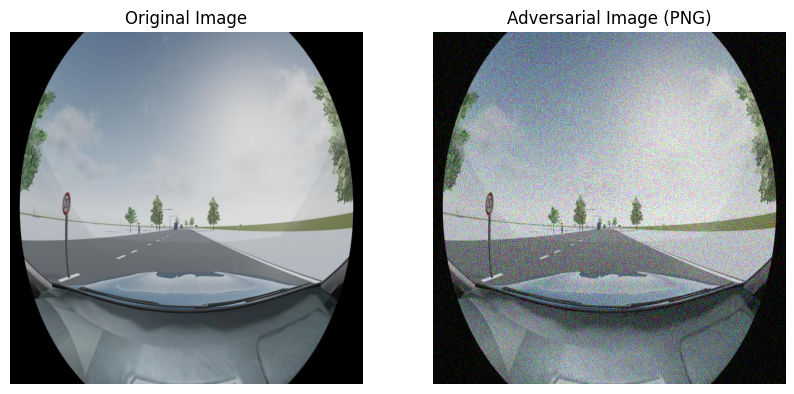

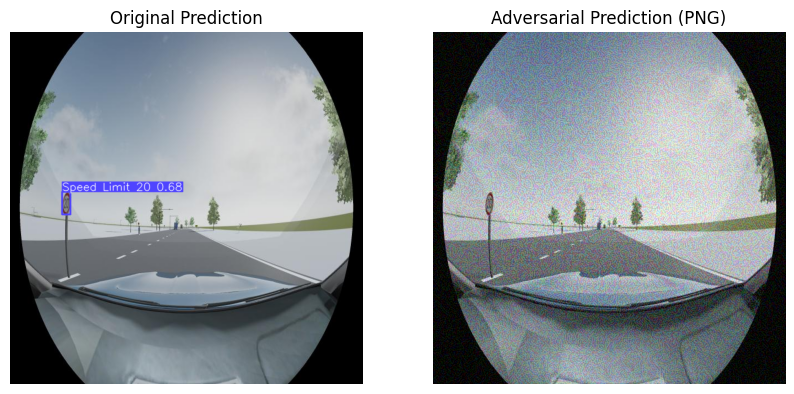

Running prediction on original tensor...

0: 640x640 1 Speed Limit 110, 12.3ms
Speed: 1.2ms preprocess, 12.3ms inference, 7.3ms postprocess per image at shape (1, 3, 640, 640)
Running prediction on loaded adversarial tensor...

0: 640x640 (no detections), 9.4ms
Speed: 1.3ms preprocess, 9.4ms inference, 5.8ms postprocess per image at shape (1, 3, 640, 640)


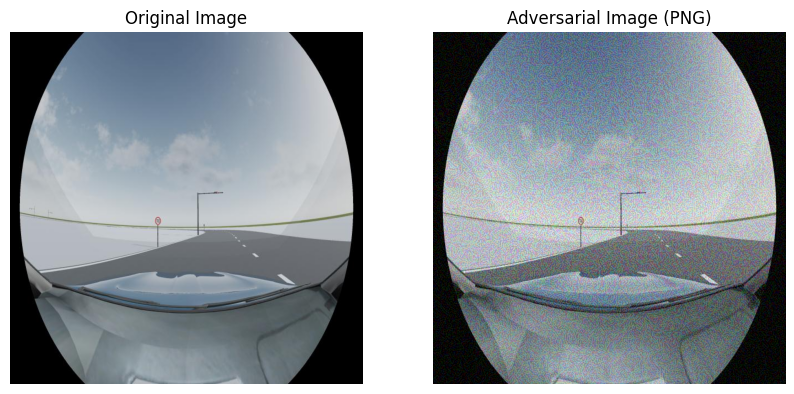

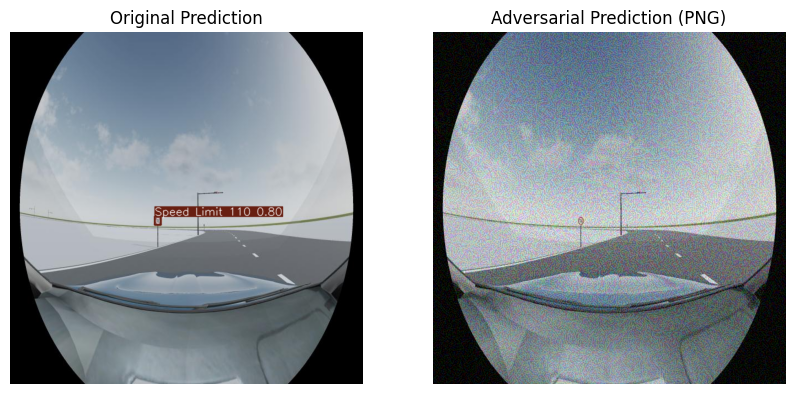

Running prediction on original tensor...

0: 640x640 (no detections), 12.4ms
Speed: 1.2ms preprocess, 12.4ms inference, 6.9ms postprocess per image at shape (1, 3, 640, 640)
Running prediction on loaded adversarial tensor...

0: 640x640 (no detections), 9.4ms
Speed: 1.3ms preprocess, 9.4ms inference, 8.6ms postprocess per image at shape (1, 3, 640, 640)


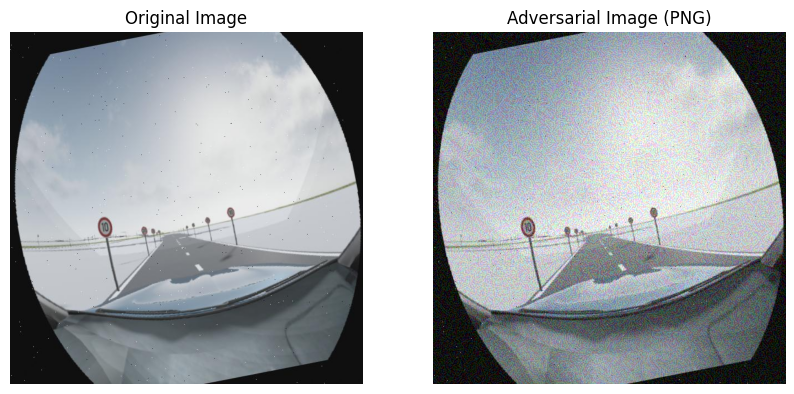

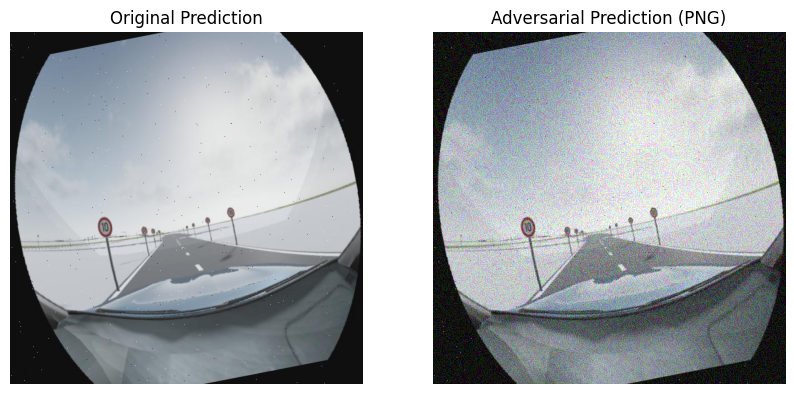

Running prediction on original tensor...

0: 640x640 1 Speed Limit 30, 13.3ms
Speed: 1.3ms preprocess, 13.3ms inference, 7.8ms postprocess per image at shape (1, 3, 640, 640)
Running prediction on loaded adversarial tensor...

0: 640x640 1 Speed Limit 30, 13.9ms
Speed: 2.3ms preprocess, 13.9ms inference, 6.6ms postprocess per image at shape (1, 3, 640, 640)


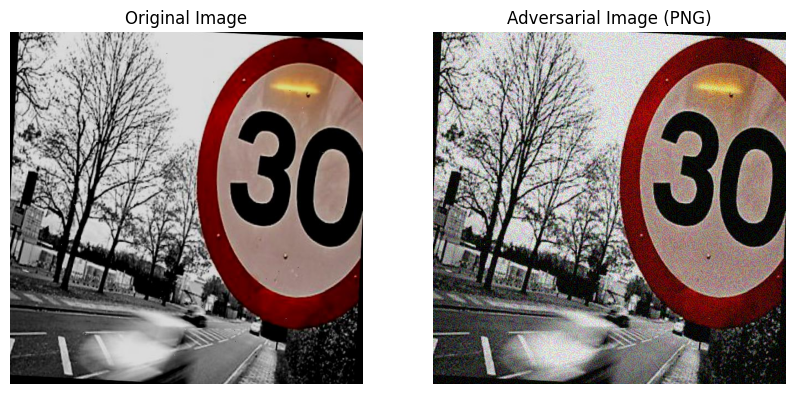

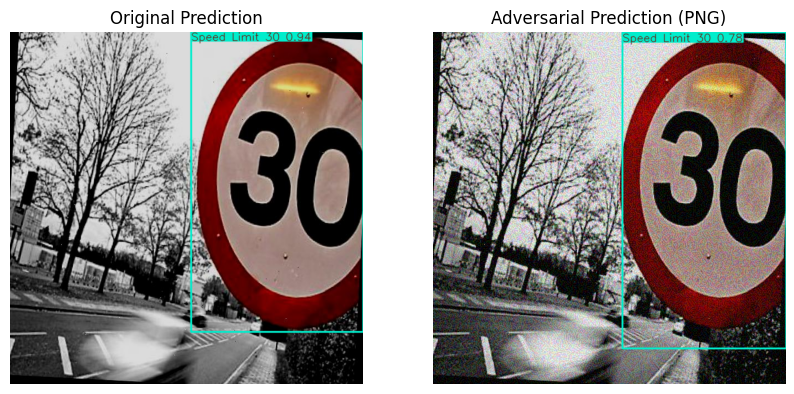

Running prediction on original tensor...

0: 640x640 1 Speed Limit 60, 10.8ms
Speed: 1.2ms preprocess, 10.8ms inference, 9.0ms postprocess per image at shape (1, 3, 640, 640)
Running prediction on loaded adversarial tensor...

0: 640x640 (no detections), 8.4ms
Speed: 1.9ms preprocess, 8.4ms inference, 5.6ms postprocess per image at shape (1, 3, 640, 640)


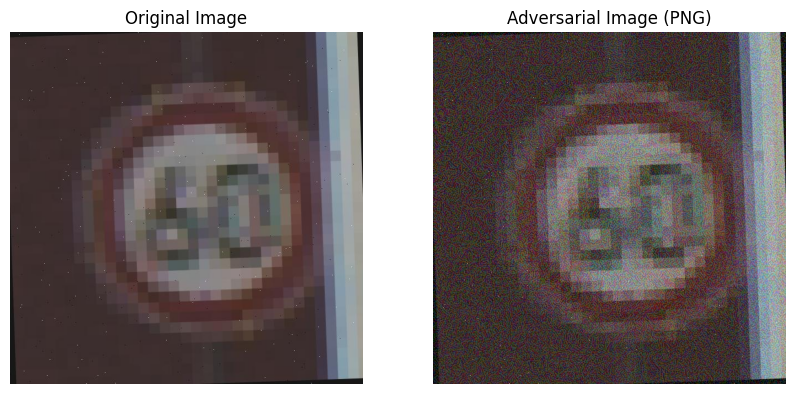

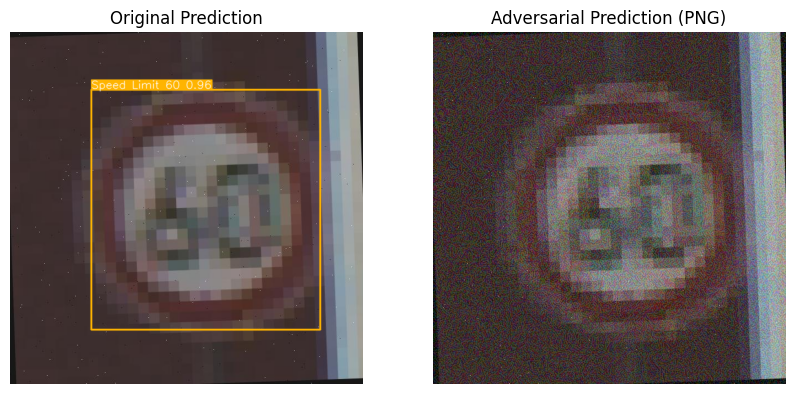

Running prediction on original tensor...

0: 640x640 1 Speed Limit 20, 14.2ms
Speed: 1.2ms preprocess, 14.2ms inference, 4.6ms postprocess per image at shape (1, 3, 640, 640)
Running prediction on loaded adversarial tensor...

0: 640x640 (no detections), 9.6ms
Speed: 1.2ms preprocess, 9.6ms inference, 6.0ms postprocess per image at shape (1, 3, 640, 640)


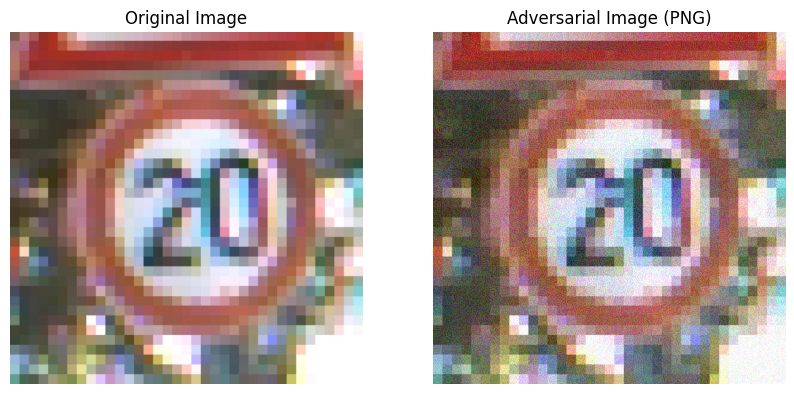

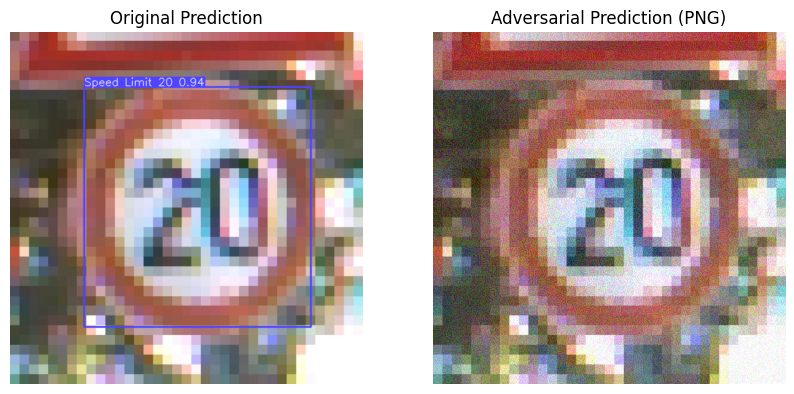

Running prediction on original tensor...

0: 640x640 (no detections), 13.8ms
Speed: 1.2ms preprocess, 13.8ms inference, 3.6ms postprocess per image at shape (1, 3, 640, 640)
Running prediction on loaded adversarial tensor...

0: 640x640 (no detections), 8.5ms
Speed: 1.2ms preprocess, 8.5ms inference, 5.7ms postprocess per image at shape (1, 3, 640, 640)


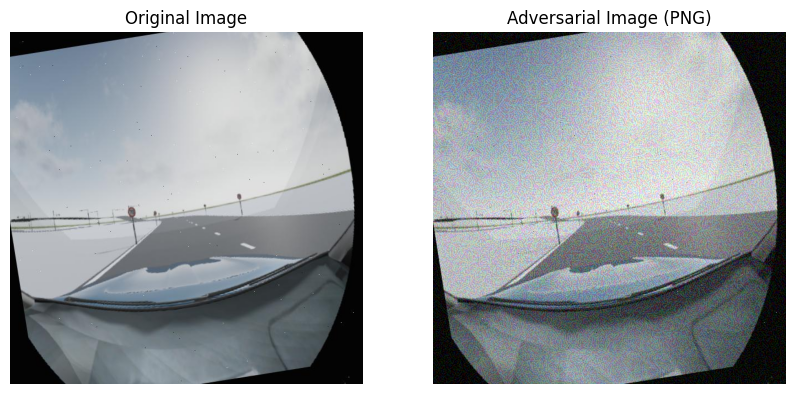

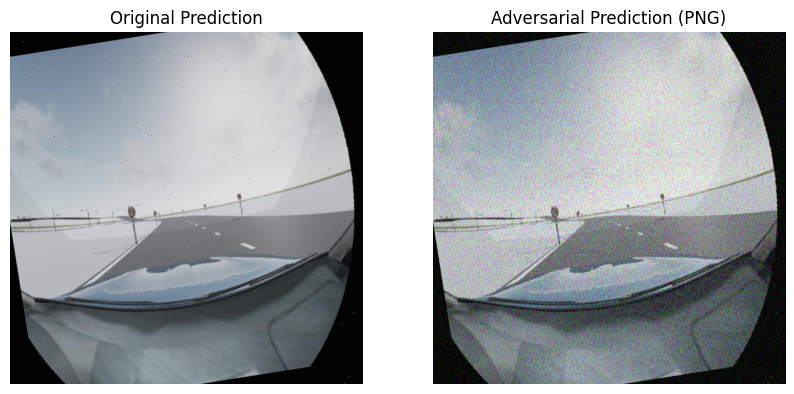

Running prediction on original tensor...

0: 640x640 1 Speed Limit 40, 13.3ms
Speed: 1.3ms preprocess, 13.3ms inference, 9.6ms postprocess per image at shape (1, 3, 640, 640)
Running prediction on loaded adversarial tensor...

0: 640x640 (no detections), 8.6ms
Speed: 1.3ms preprocess, 8.6ms inference, 6.0ms postprocess per image at shape (1, 3, 640, 640)


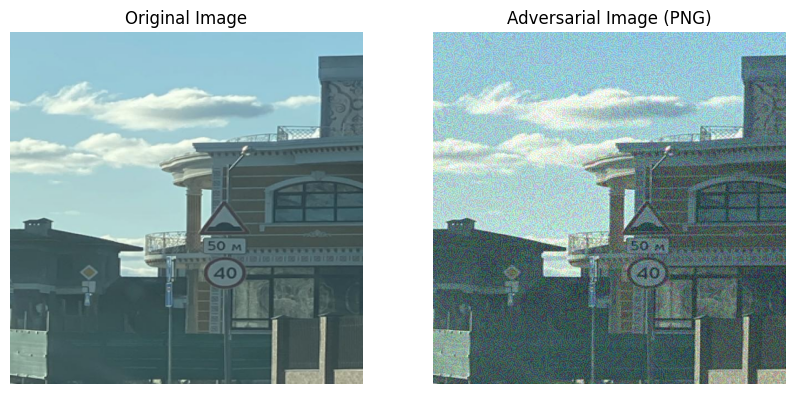

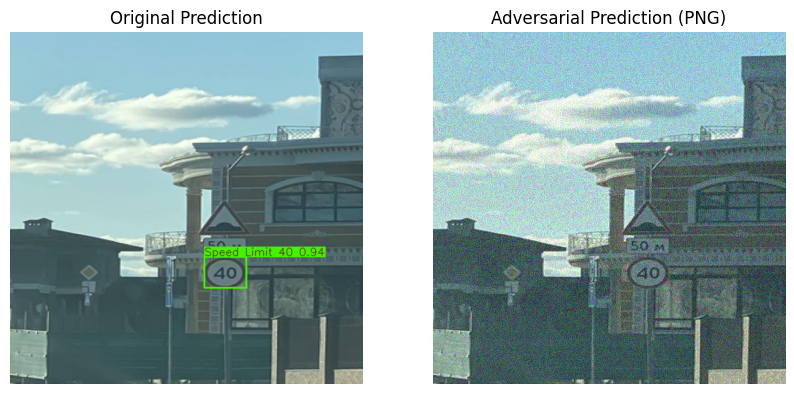

Running prediction on original tensor...

0: 640x640 1 Stop, 9.2ms
Speed: 1.2ms preprocess, 9.2ms inference, 4.5ms postprocess per image at shape (1, 3, 640, 640)
Running prediction on loaded adversarial tensor...

0: 640x640 (no detections), 8.8ms
Speed: 2.8ms preprocess, 8.8ms inference, 5.8ms postprocess per image at shape (1, 3, 640, 640)


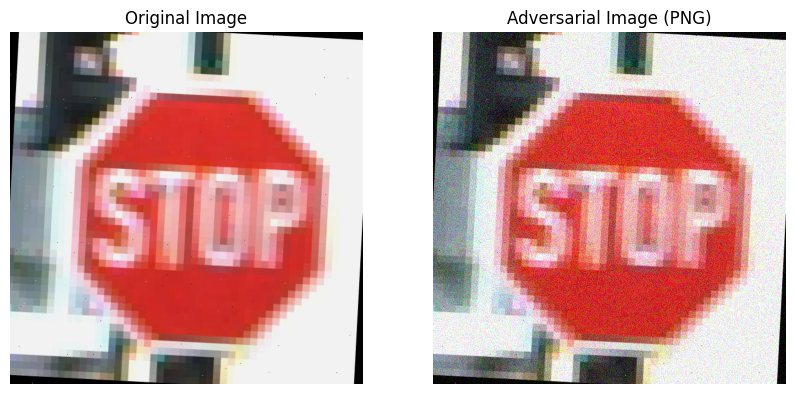

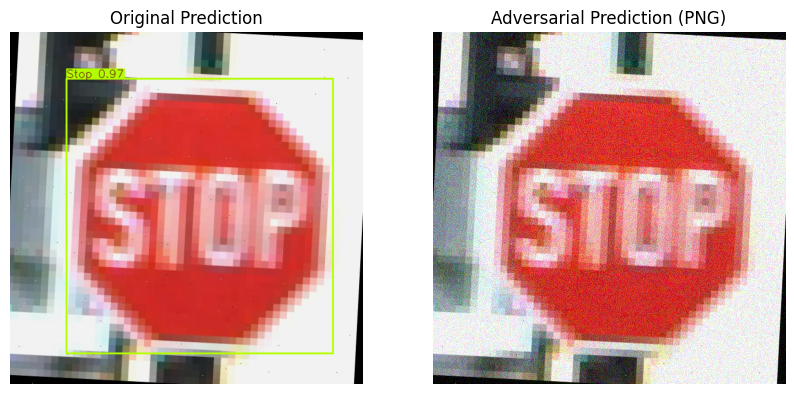

Running prediction on original tensor...

0: 640x640 1 Speed Limit 30, 10.9ms
Speed: 1.2ms preprocess, 10.9ms inference, 6.0ms postprocess per image at shape (1, 3, 640, 640)
Running prediction on loaded adversarial tensor...

0: 640x640 (no detections), 8.7ms
Speed: 1.2ms preprocess, 8.7ms inference, 6.0ms postprocess per image at shape (1, 3, 640, 640)


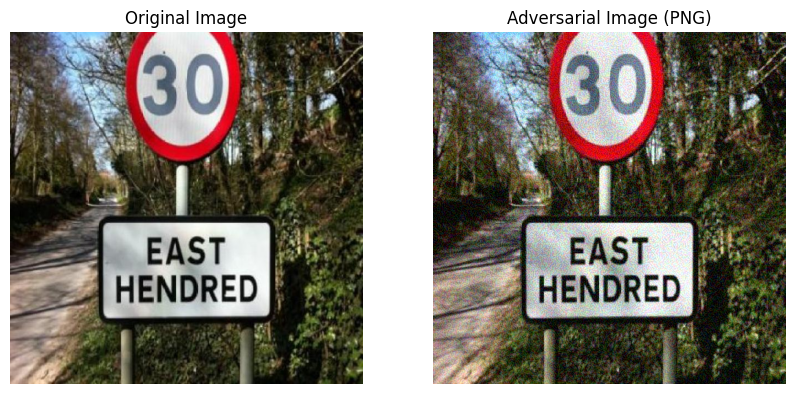

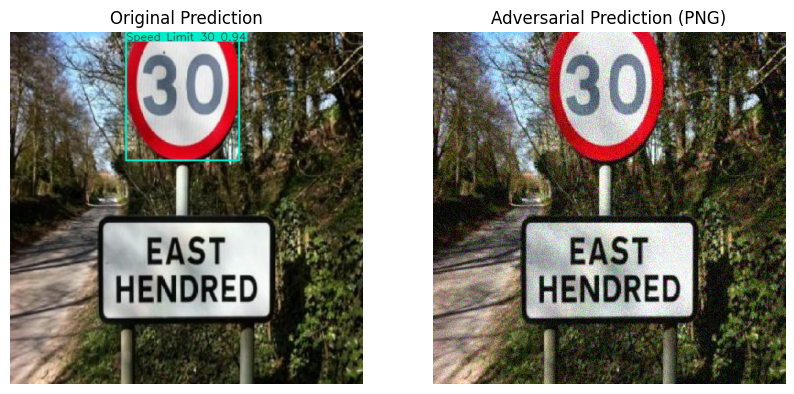

Running prediction on original tensor...

0: 640x640 1 Speed Limit 50, 15.9ms
Speed: 1.2ms preprocess, 15.9ms inference, 6.6ms postprocess per image at shape (1, 3, 640, 640)
Running prediction on loaded adversarial tensor...

0: 640x640 (no detections), 12.8ms
Speed: 1.2ms preprocess, 12.8ms inference, 5.8ms postprocess per image at shape (1, 3, 640, 640)


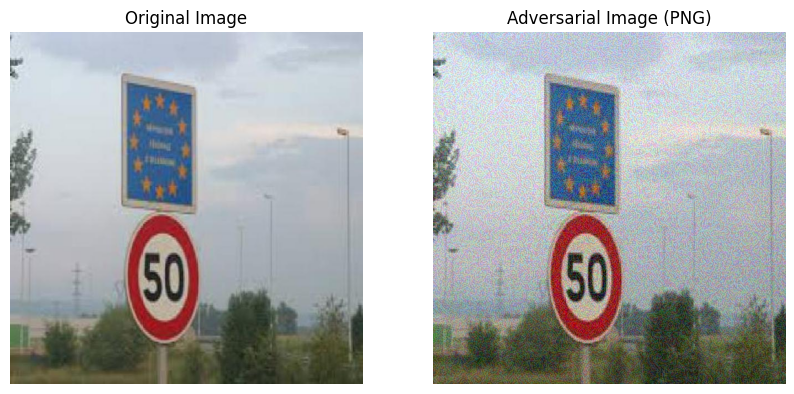

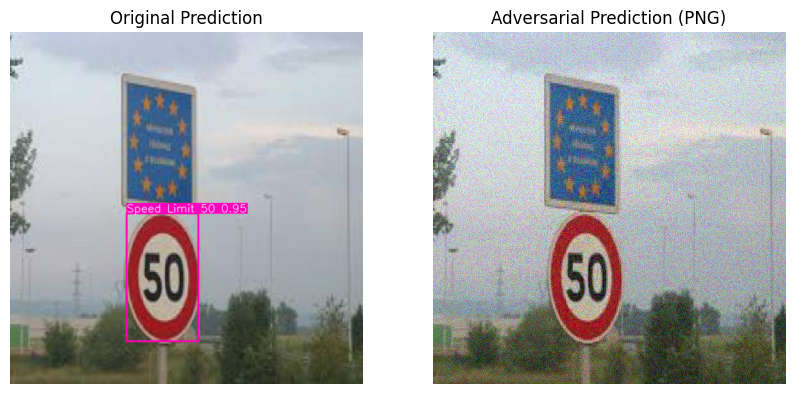

Running prediction on original tensor...

0: 640x640 1 Speed Limit 40, 12.0ms
Speed: 1.2ms preprocess, 12.0ms inference, 6.3ms postprocess per image at shape (1, 3, 640, 640)
Running prediction on loaded adversarial tensor...

0: 640x640 1 Speed Limit 40, 11.8ms
Speed: 1.2ms preprocess, 11.8ms inference, 9.7ms postprocess per image at shape (1, 3, 640, 640)


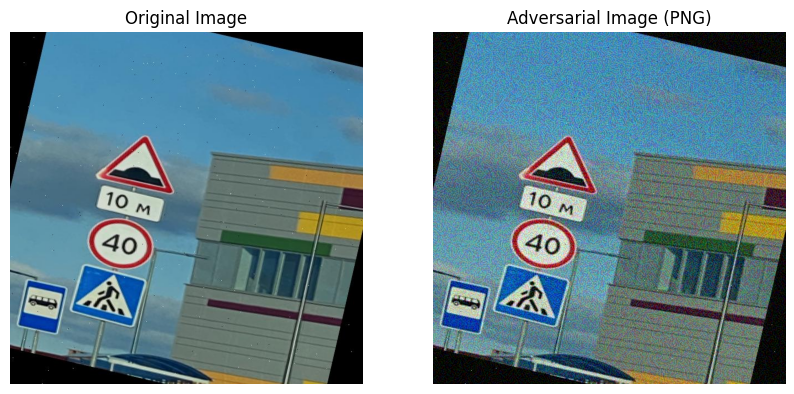

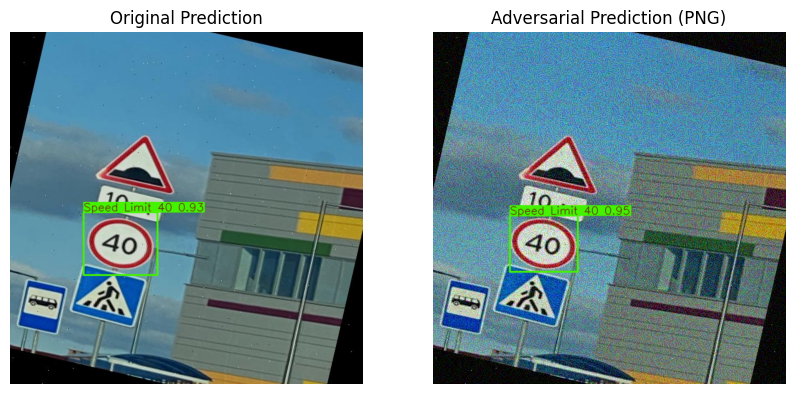

Running prediction on original tensor...

0: 640x640 1 Green Light, 11.0ms
Speed: 1.1ms preprocess, 11.0ms inference, 4.6ms postprocess per image at shape (1, 3, 640, 640)
Running prediction on loaded adversarial tensor...

0: 640x640 1 Green Light, 12.0ms
Speed: 1.2ms preprocess, 12.0ms inference, 6.9ms postprocess per image at shape (1, 3, 640, 640)


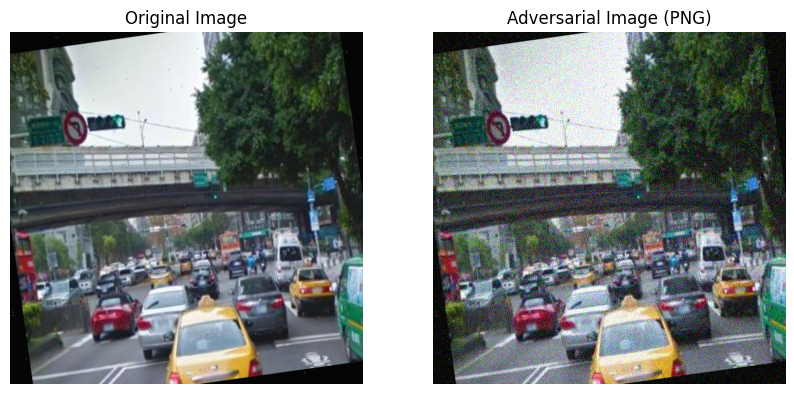

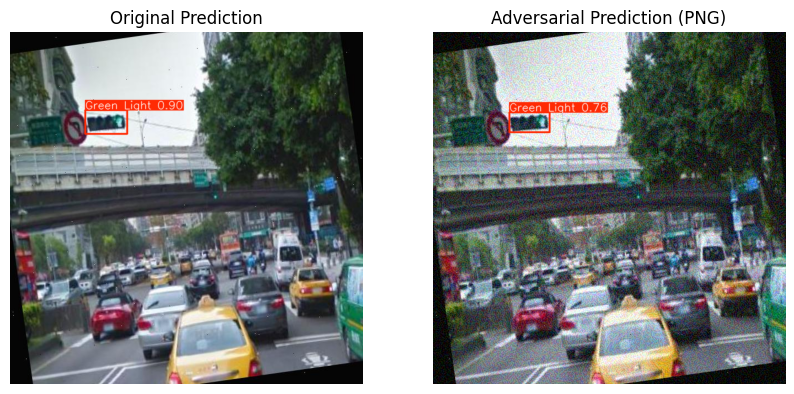

Running prediction on original tensor...

0: 640x640 1 Speed Limit 120, 16.0ms
Speed: 5.3ms preprocess, 16.0ms inference, 4.8ms postprocess per image at shape (1, 3, 640, 640)
Running prediction on loaded adversarial tensor...

0: 640x640 (no detections), 12.1ms
Speed: 1.2ms preprocess, 12.1ms inference, 11.0ms postprocess per image at shape (1, 3, 640, 640)


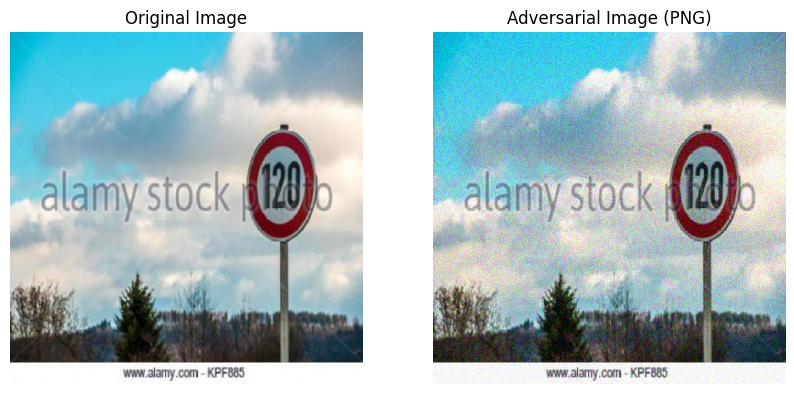

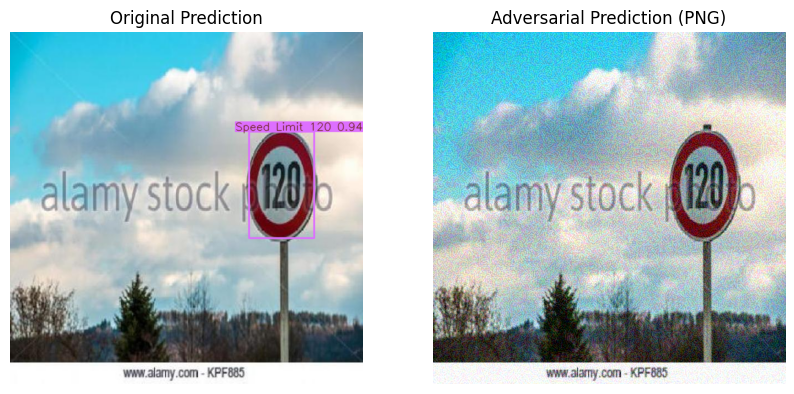

Running prediction on original tensor...

0: 640x640 1 Speed Limit 100, 11.4ms
Speed: 1.1ms preprocess, 11.4ms inference, 4.4ms postprocess per image at shape (1, 3, 640, 640)
Running prediction on loaded adversarial tensor...

0: 640x640 (no detections), 8.7ms
Speed: 1.3ms preprocess, 8.7ms inference, 6.0ms postprocess per image at shape (1, 3, 640, 640)


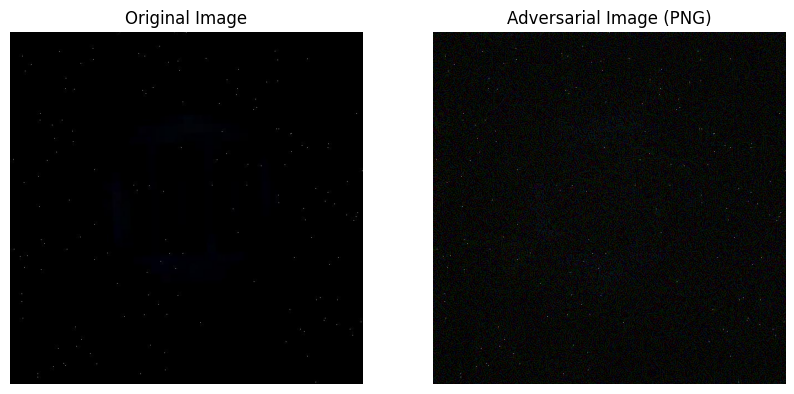

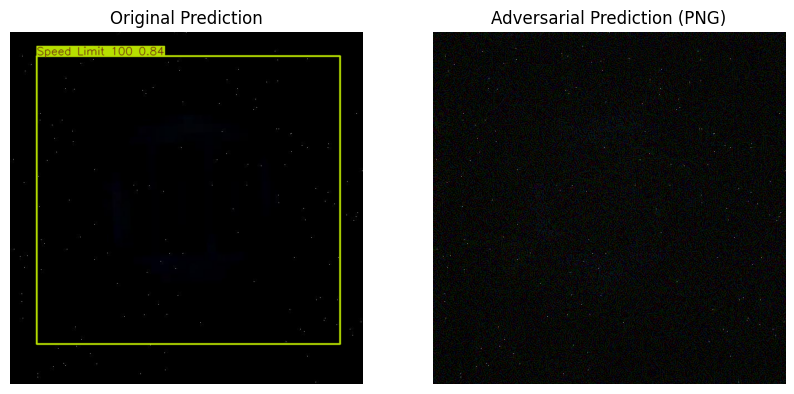

Running prediction on original tensor...

0: 640x640 1 Speed Limit 70, 12.9ms
Speed: 1.2ms preprocess, 12.9ms inference, 7.6ms postprocess per image at shape (1, 3, 640, 640)
Running prediction on loaded adversarial tensor...

0: 640x640 (no detections), 9.7ms
Speed: 1.3ms preprocess, 9.7ms inference, 9.2ms postprocess per image at shape (1, 3, 640, 640)


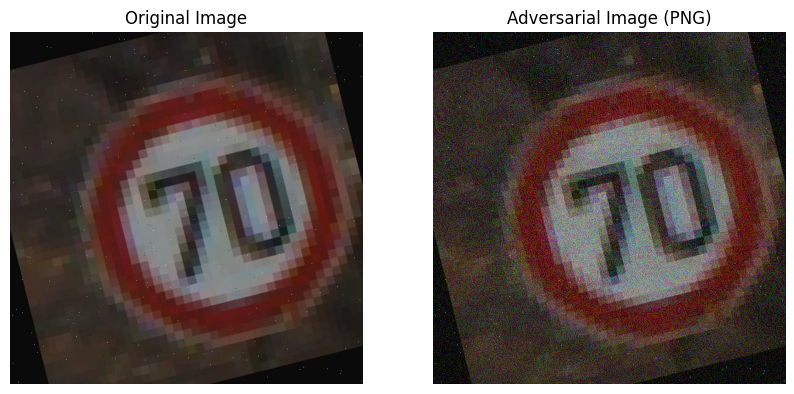

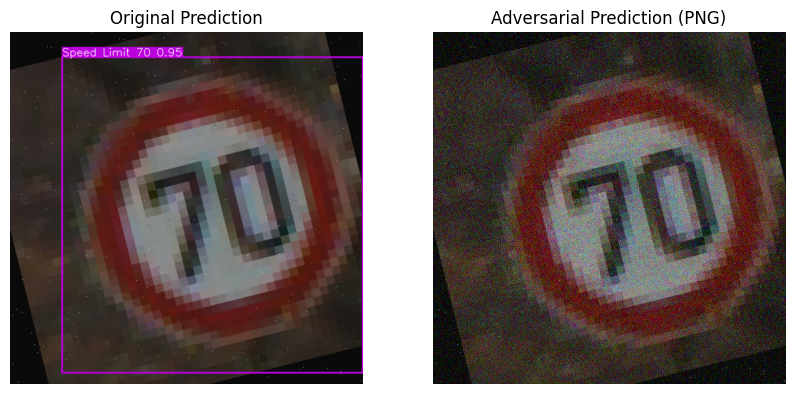

In [16]:
for image_path in test_images_paths:
    test_image = preprocess_image(image_path)
    test_image = test_image.to(device)
    adv = test_image+delta
    compare_original_and_adversarial_png(model,image_path,adv,0.5)